# **Credit Card Fraud Detection**
**Anonymized credit card transactions labeled as fraudulent or genuine**

<img src="https://1.bp.blogspot.com/-d8quHeA23kA/XRH_AeTzRZI/AAAAAAAACYc/w4Qulnhld7g3msiQ17uxVaLwhOA_lQZdQCLcBGAs/s1600/credit%2Bcard.jpg" />

# Introduction

It is important that credit card companies are able to recognize fraudulent credit card transactions so that customers are not charged for items that they did not purchase. Eventually, it is also important for companies NOT to detect transactions which are genuine as fraudulent, otherwise, companies would keep blocking the credit card, and which may lead to customer dissatisfaction.

# Import Libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import plotly.express as px
import math




# Setting seabon style
sns.set(style='darkgrid', palette='colorblind')

# Load Data

In [2]:
df = pd.read_csv('creditcard.csv')

In [3]:
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [4]:
# Converting all column names to lower case
df.columns = df.columns.str.lower()

# Exploratory Data Analysis

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   time    284807 non-null  float64
 1   v1      284807 non-null  float64
 2   v2      284807 non-null  float64
 3   v3      284807 non-null  float64
 4   v4      284807 non-null  float64
 5   v5      284807 non-null  float64
 6   v6      284807 non-null  float64
 7   v7      284807 non-null  float64
 8   v8      284807 non-null  float64
 9   v9      284807 non-null  float64
 10  v10     284807 non-null  float64
 11  v11     284807 non-null  float64
 12  v12     284807 non-null  float64
 13  v13     284807 non-null  float64
 14  v14     284807 non-null  float64
 15  v15     284807 non-null  float64
 16  v16     284807 non-null  float64
 17  v17     284807 non-null  float64
 18  v18     284807 non-null  float64
 19  v19     284807 non-null  float64
 20  v20     284807 non-null  float64
 21  v21     28

In [6]:
df[['time','amount']].describe()

,time,amount
count,284807.000000,284807.000000
mean,94813.859575,88.349619
std,47488.145955,250.120109
min,0.000000,0.000000
25%,54201.500000,5.600000
50%,84692.000000,22.000000
75%,139320.500000,77.165000
max,172792.000000,25691.160000


### Count unique values of labe

In [7]:
print(df['class'].value_counts())
print('\n')
print(df['class'].value_counts(normalize=True))

class
0    284315
1       492
Name: count, dtype: int64


class
0    0.998273
1    0.001727
Name: proportion, dtype: float64


## Fraudulent and Non-Fraudulent Distribution

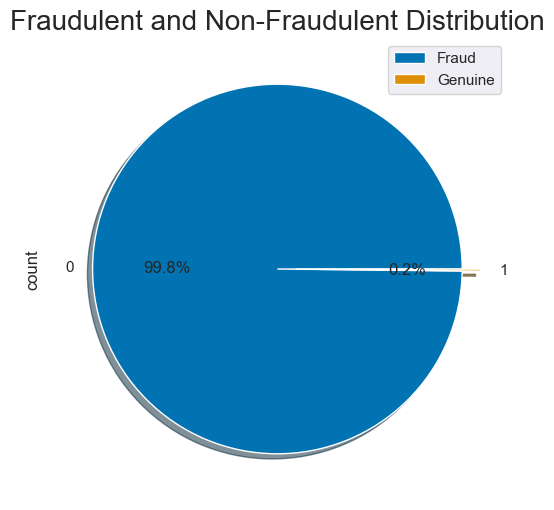

In [8]:
df["class"].value_counts().plot(kind = 'pie',explode=[0, 0.1],figsize=(6, 6),autopct='%1.1f%%',shadow=True)
plt.title("Fraudulent and Non-Fraudulent Distribution",fontsize=20)
plt.legend(["Fraud", "Genuine"])
plt.show()

In [9]:
# Dealing with missing data
df.isnull().sum().max()

0

## Distribution of Amount

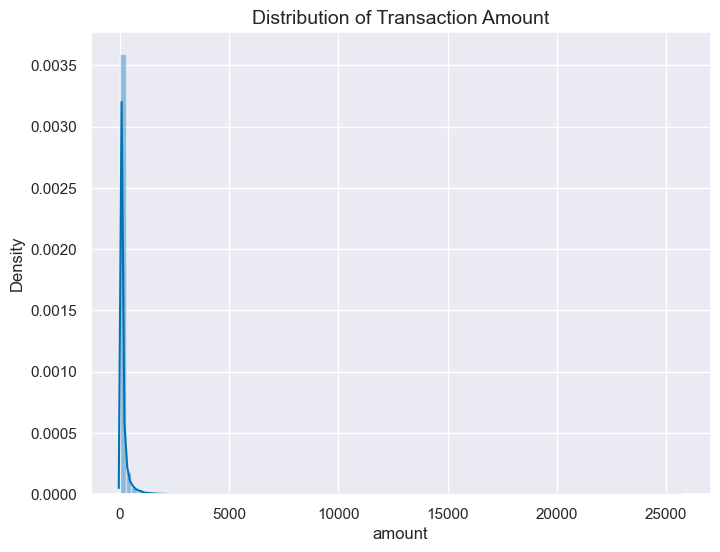

In [10]:
plt.figure(figsize=(8,6))
plt.title('Distribution of Transaction Amount', fontsize=14)
sns.distplot(df['amount'], bins=100)
plt.show()

## Distribution of Amount for Fradulent & Genuine transactions

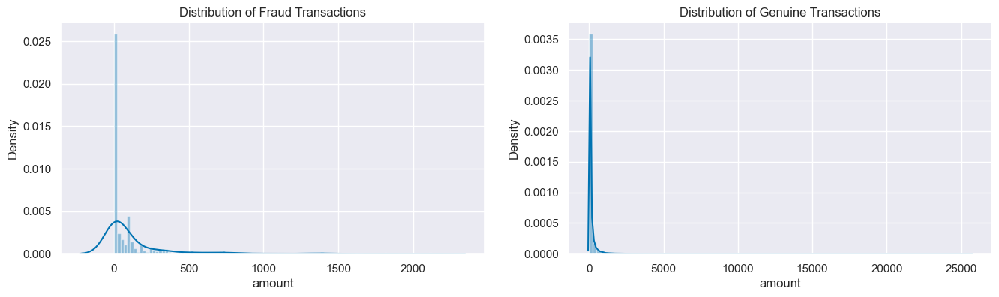

In [11]:
fig, axs = plt.subplots(ncols=2,figsize=(16,4))
sns.distplot(df[df['class'] == 1]['amount'], bins=100, ax=axs[0])
axs[0].set_title("Distribution of Fraud Transactions")

sns.distplot(df[df['class'] == 0]['amount'], bins=100, ax=axs[1])
axs[1].set_title("Distribution of Genuine Transactions")

plt.show()

In [12]:
print("Fraud Transaction distribution : \n",df[(df['class'] == 1)]['amount'].value_counts().head())
print("\n")
print("Maximum amount of fraud transaction - ",df[(df['class'] == 1)]['amount'].max())
print("Minimum amount of fraud transaction - ",df[(df['class'] == 1)]['amount'].min())

Fraud Transaction distribution : 
 amount
1.00     113
0.00      27
99.99     27
0.76      17
0.77      10
Name: count, dtype: int64


Maximum amount of fraud transaction -  2125.87
Minimum amount of fraud transaction -  0.0


In [13]:
print("Genuine Transaction distribution : \n",df[(df['class'] == 0)]['amount'].value_counts().head())
print("\n")
print("Maximum amount of Genuine transaction - ",df[(df['class'] == 0)]['amount'].max())
print("Minimum amount of Genuine transaction - ",df[(df['class'] == 0)]['amount'].min())

Genuine Transaction distribution : 
 amount
1.00     13575
1.98      6044
0.89      4872
9.99      4746
15.00     3280
Name: count, dtype: int64


Maximum amount of Genuine transaction -  25691.16
Minimum amount of Genuine transaction -  0.0


## Distribution of Amount w.r.t Class

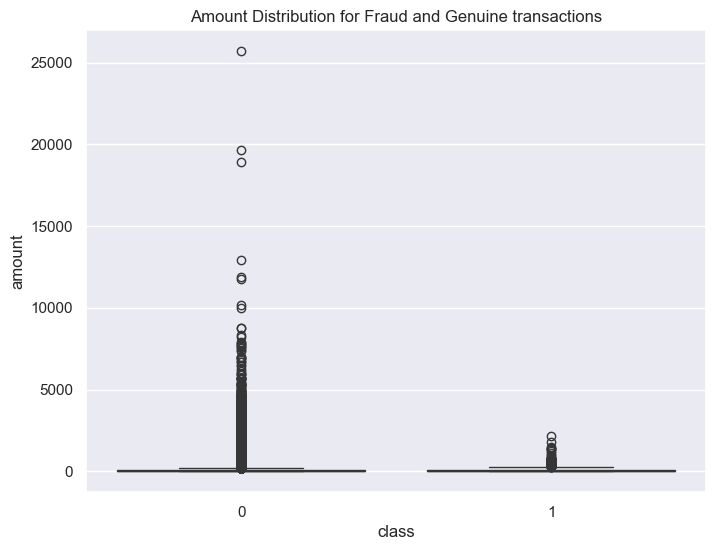

In [14]:
plt.figure(figsize=(8,6))
sns.boxplot(x='class', y='amount',data = df)
plt.title('Amount Distribution for Fraud and Genuine transactions')
plt.show()

## Distribution of Time

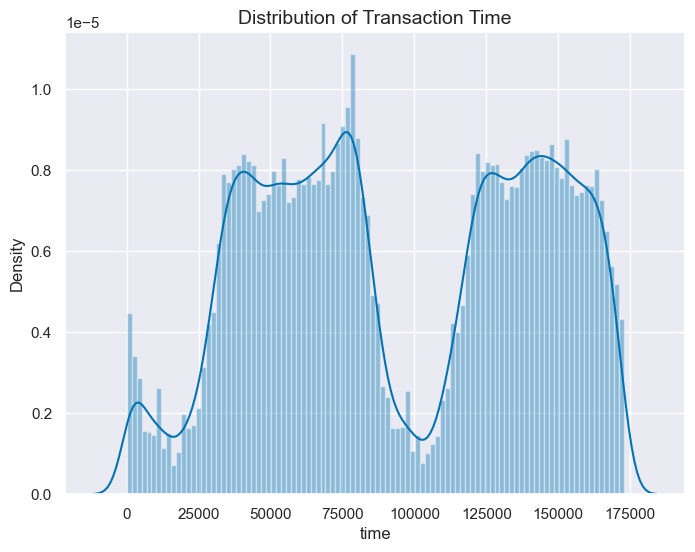

In [15]:
plt.figure(figsize=(8,6))
plt.title('Distribution of Transaction Time', fontsize=14)
sns.distplot(df['time'], bins=100)
plt.show()

## Distribution of time w.r.t. transactions types

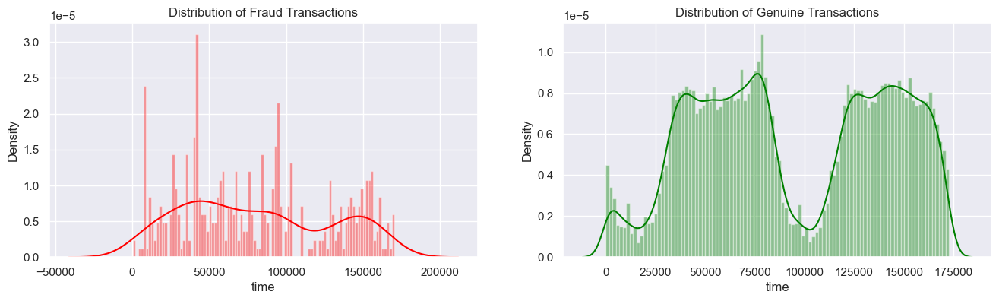

In [16]:
fig, axs = plt.subplots(ncols=2, figsize=(16,4))

sns.distplot(df[(df['class'] == 1)]['time'], bins=100, color='red', ax=axs[0])
axs[0].set_title("Distribution of Fraud Transactions")

sns.distplot(df[(df['class'] == 0)]['time'], bins=100, color='green', ax=axs[1])
axs[1].set_title("Distribution of Genuine Transactions")

plt.show()

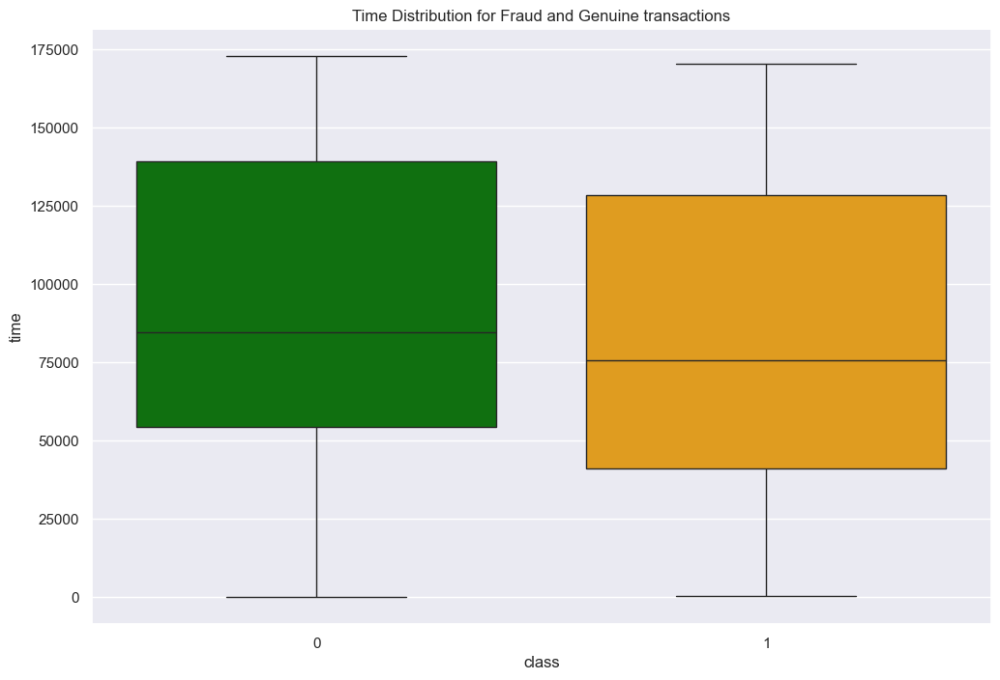

In [17]:
plt.figure(figsize=(12,8))
sns.boxplot(x='class', y='time', data=df, palette=['green', 'orange'])
plt.title('Time Distribution for Fraud and Genuine transactions')
plt.show()

## Distribution of transaction type w.r.t amount

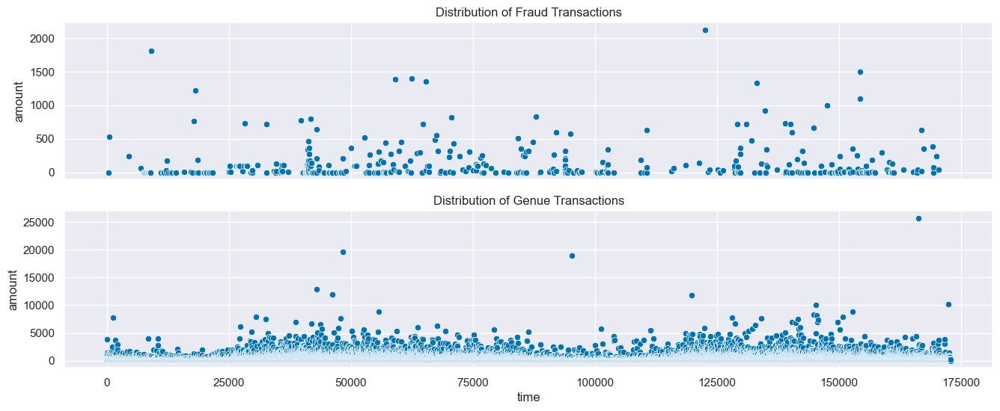

In [18]:
fig, axs = plt.subplots(nrows=2,sharex=True,figsize=(16,6))

sns.scatterplot(x='time',y='amount', data=df[df['class']==1], ax=axs[0])
axs[0].set_title("Distribution of Fraud Transactions")

sns.scatterplot(x='time',y='amount', data=df[df['class']==0], ax=axs[1])
axs[1].set_title("Distribution of Genue Transactions")

plt.show()

## Categorical vs Continuous Features

In [19]:
# Finging unique values for each column
df[['time','amount','class']].nunique()

time      124592
amount     32767
class          2
dtype: int64

In [20]:
fig = px.scatter(df, x="time", y="amount", color="class", 
                 marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white")
fig.show()

## Correlation Among Explanatory Variables

In [21]:
df[['time','amount','class']].corr()['class'].sort_values(ascending=False).head(10)

class     1.000000
amount    0.005632
time     -0.012323
Name: class, dtype: float64

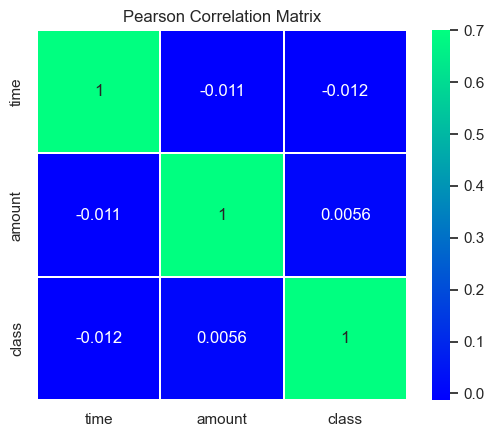

In [22]:
plt.title('Pearson Correlation Matrix')
sns.heatmap(df[['time', 'amount','class']].corr(),linewidths=0.25,vmax=0.7,square=True,cmap="winter",
            linecolor='w',annot=True);

## Lets check the data again after cleaning

In [23]:
df.shape

(284807, 31)

In [24]:
df['class'].value_counts(normalize=True)

class
0    0.998273
1    0.001727
Name: proportion, dtype: float64

# Feature Engineering

### Converting time from second to hour

In [25]:
# Converting time from second to hour
df['time'] = df['time'].apply(lambda sec : (sec/3600))

### Calculating hour of the day

In [26]:
# Calculating hour of the day
df['hour'] = df['time']%24   # 2 days of data
df['hour'] = df['hour'].apply(lambda x : math.floor(x))

### Calculating First and Second Day

In [27]:
# Calculating First and Second day
df['day'] = df['time']/24   # 2 days of data
df['day'] = df['day'].apply(lambda x : 1 if(x==0) else math.ceil(x))

In [28]:
df[['time','hour','day','amount','class']]

,time,hour,day,amount,class
0,0.000000,0,1,149.62,0
1,0.000000,0,1,2.69,0
2,0.000278,0,1,378.66,0
3,0.000278,0,1,123.50,0
4,0.000556,0,1,69.99,0
...,...,...,...,...,...
284802,47.996111,23,2,0.77,0
284803,47.996389,23,2,24.79,0
284804,47.996667,23,2,67.88,0
284805,47.996667,23,2,10.00,0


### Fraud and Genuine transaction Day wise

In [29]:
# calculating fraud transaction daywise
dayFrdTran = df[(df['class'] == 1)]['day'].value_counts()

# calculating genuine transaction daywise
dayGenuTran = df[(df['class'] == 0)]['day'].value_counts()

# calculating total transaction daywise
dayTran = df['day'].value_counts()

print("No of transaction Day wise:")
print(dayTran)

print("\n")

print("No of fraud transaction Day wise:")
print(dayFrdTran)

print("\n")

print("No of genuine transactions Day wise:")
print(dayGenuTran)

print("\n")

print("Percentage of fraud transactions Day wise:")
print((dayFrdTran/dayTran)*100)

No of transaction Day wise:
day
1    144787
2    140020
Name: count, dtype: int64


No of fraud transaction Day wise:
day
1    281
2    211
Name: count, dtype: int64


No of genuine transactions Day wise:
day
1    144506
2    139809
Name: count, dtype: int64


Percentage of fraud transactions Day wise:
day
1    0.194078
2    0.150693
Name: count, dtype: float64


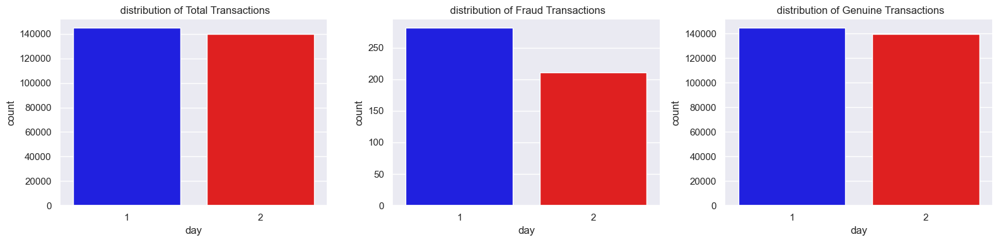

In [30]:
fraud = df[df['class'] == 1]
genuine = df[df['class'] == 0]

fig, axs = plt.subplots(ncols=3, figsize=(16, 4))

sns.countplot(data=df, x='day', ax=axs[0], palette=['blue','red'])
axs[0].set_title(" distribution of Total Transactions")

sns.countplot(data=fraud, x='day', ax=axs[1], palette=['blue','red'])
axs[1].set_title(" distribution of Fraud Transactions")

sns.countplot(data=genuine, x='day', ax=axs[2], palette=['blue','red'])
axs[2].set_title(" distribution of Genuine Transactions")

plt.tight_layout()
plt.show()

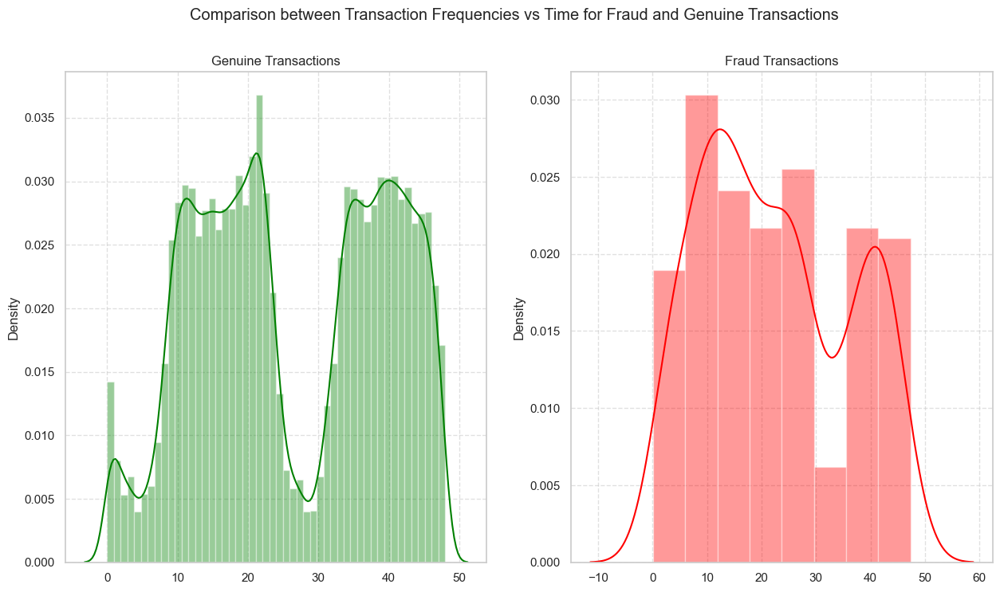

In [31]:
# Time plots 
sns.set_style("whitegrid")
fig , axs = plt.subplots(nrows = 1 , ncols = 2 , figsize = (15,8))

sns.distplot(df[df['class']==0]['time'].values , color = 'green' , ax = axs[0])
axs[0].set_title('Genuine Transactions')
axs[0].grid(True, linestyle='--', alpha=0.6)

sns.distplot(df[df['class']==1]['time'].values , color = 'red' ,ax = axs[1])
axs[1].set_title('Fraud Transactions')
axs[1].grid(True, linestyle='--', alpha=0.6)

fig.suptitle('Comparison between Transaction Frequencies vs Time for Fraud and Genuine Transactions')
plt.show()

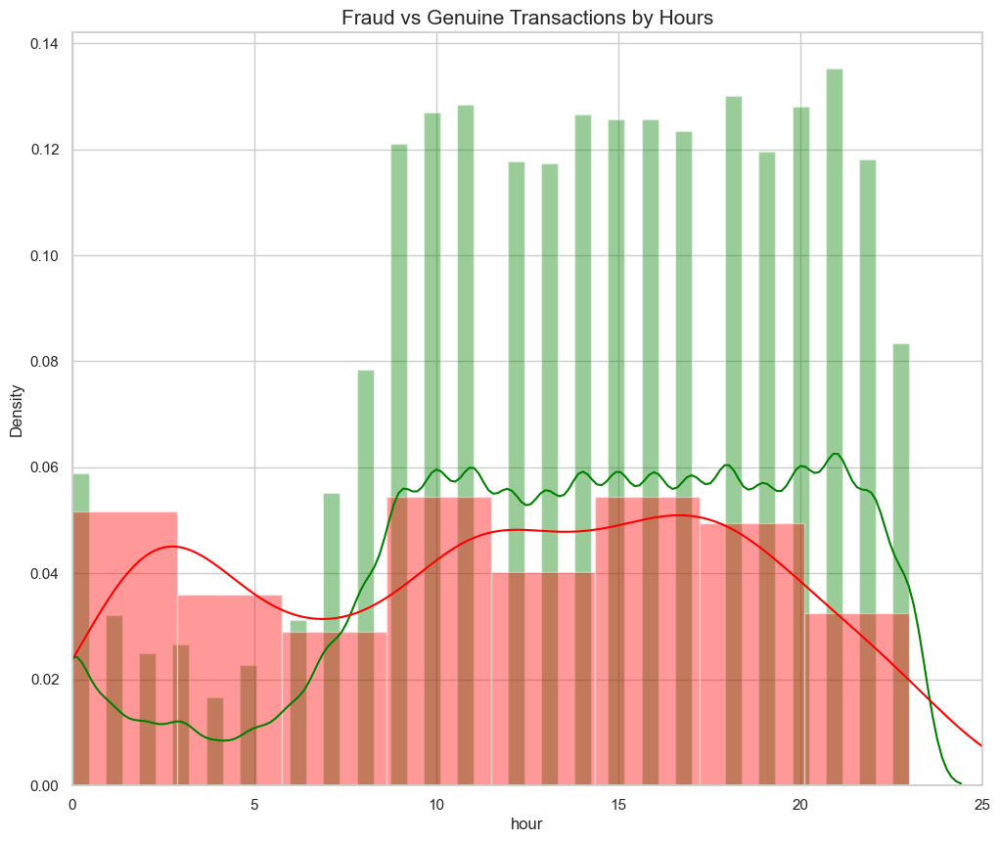

In [32]:
# Let's see if we find any particular pattern between time ( in hours ) and Fraud vs Genuine Transactions

plt.figure(figsize=(12,10))

sns.distplot(df[df['class'] == 0]["hour"], color='green') # Genuine - green
sns.distplot(df[df['class'] == 1]["hour"], color='red') # Fraudulent - Red

plt.title('Fraud vs Genuine Transactions by Hours', fontsize=15)
plt.xlim([0,25])
plt.show()

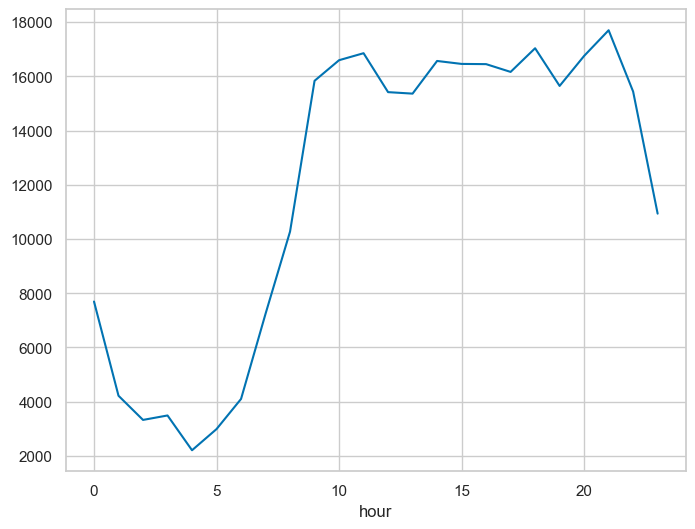

In [33]:
plt.figure(figsize=(8,6))
df[['time','hour','day','amount','class']].groupby('hour').count()['class'].plot()
plt.show()

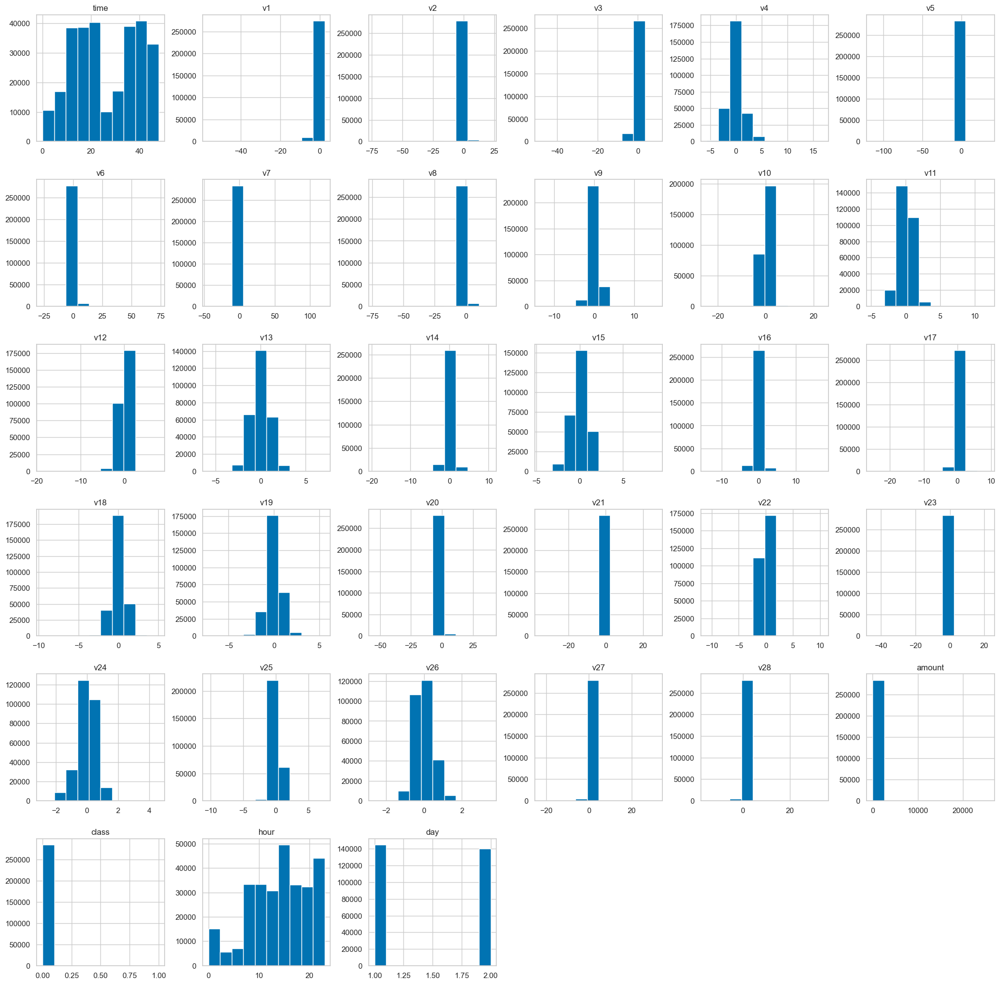

In [34]:
df.hist(figsize = (25,25))
plt.show()

## Reset the index

In [35]:
df.reset_index(inplace = True , drop = True)

# Scale Amount Feature

##  Scale amount by Log

In [36]:
# Adding a small amount of 0.0001 to amount as log of zero is infinite.
df['amount_log'] = np.log(df.amount + 0.0001)

## Scale  amount by Standardization

In [37]:
from sklearn.preprocessing import StandardScaler # importing a class from a module of a library

ss = StandardScaler() # object of the class StandardScaler ()
df['amount_scaled'] = ss.fit_transform(df['amount'].values.reshape(-1,1))

## Scale  amount by Normalization

In [38]:
from sklearn.preprocessing import MinMaxScaler

mm = MinMaxScaler() # object of the class StandardScaler ()
df['amount_minmax'] = mm.fit_transform(df['amount'].values.reshape(-1,1))

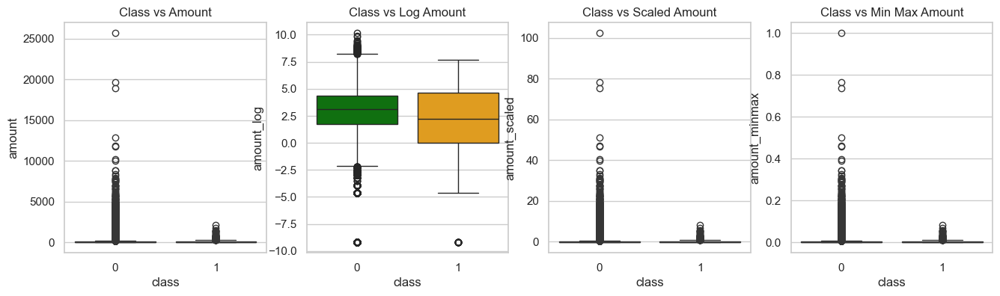

In [39]:
#Feature engineering to a better visualization of the values

# Let's explore the Amount by Class and see the distribuition of Amount transactions
fig , axs = plt.subplots(nrows = 1 , ncols = 4 , figsize = (16,4))

sns.boxplot(x ="class",y="amount",data=df, ax = axs[0])
axs[0].set_title("Class vs Amount")

sns.boxplot(x ="class",y="amount_log",data=df, ax = axs[1],palette=['green','orange'])
axs[1].set_title("Class vs Log Amount")

sns.boxplot(x ="class",y="amount_scaled",data=df, ax = axs[2])
axs[2].set_title("Class vs Scaled Amount")

sns.boxplot(x ="class",y="amount_minmax",data=df, ax = axs[3])
axs[3].set_title("Class vs Min Max Amount")

# fig.suptitle('Amount by Class', fontsize=20)
plt.show()

In [40]:
df[['time','hour','day','amount','amount_log','amount_scaled','amount_minmax','class']]

,time,hour,day,amount,amount_log,amount_scaled,amount_minmax,class
0,0.000000,0,1,149.62,5.008099,0.244964,0.005824,0
1,0.000000,0,1,2.69,0.989578,-0.342475,0.000105,0
2,0.000278,0,1,378.66,5.936639,1.160686,0.014739,0
3,0.000278,0,1,123.50,4.816242,0.140534,0.004807,0
4,0.000556,0,1,69.99,4.248354,-0.073403,0.002724,0
...,...,...,...,...,...,...,...,...
284802,47.996111,23,2,0.77,-0.261235,-0.350151,0.000030,0
284803,47.996389,23,2,24.79,3.210444,-0.254117,0.000965,0
284804,47.996667,23,2,67.88,4.217743,-0.081839,0.002642,0
284805,47.996667,23,2,10.00,2.302595,-0.313249,0.000389,0


# Splitting data into Training and Testing samples

In [41]:
df.columns

Index(['time', 'v1', 'v2', 'v3', 'v4', 'v5', 'v6', 'v7', 'v8', 'v9', 'v10',
       'v11', 'v12', 'v13', 'v14', 'v15', 'v16', 'v17', 'v18', 'v19', 'v20',
       'v21', 'v22', 'v23', 'v24', 'v25', 'v26', 'v27', 'v28', 'amount',
       'class', 'hour', 'day', 'amount_log', 'amount_scaled', 'amount_minmax'],
      dtype='object')

In [42]:
X = df.drop(['time','class','hour','day','amount','amount_minmax','amount_scaled'],axis=1)
y = df['class']

In [43]:
X

,v1,v2,v3,v4,v5,v6,v7,v8,v9,v10,...,v20,v21,v22,v23,v24,v25,v26,v27,v28,amount_log
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,5.008099
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0.989578
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,5.936639
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,4.816242
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,4.248354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,...,1.475829,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,-0.261235
284803,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,...,0.059616,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,3.210444
284804,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,...,0.001396,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,4.217743
284805,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,...,0.127434,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,2.302595


In [44]:
# Load the library for splitting the data
from sklearn.model_selection import train_test_split

In [45]:
# Split the data into training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, shuffle=True, random_state=101)

In [46]:
print("X_train - ",X_train.shape)
print("y_train - ",y_train.shape)
print("X_test - ",X_test.shape)
print("y_test - ",y_test.shape)

X_train -  (199364, 29)
y_train -  (199364,)
X_test -  (85443, 29)
y_test -  (85443,)


# Baseline for models

## 1  __Classification Models__

- Logistic Regression
- Decision Trees
- Random Forest
- Naive Bayes Classifier 

2  __Class Imbalance Solutions__

- Under Sampling
- Over Sampling
- SMOTE
- ADASYN

3  __Metrics__

- Accuracy Score
- Confusion Matrix
- Precision Score
- Recall Score
- ROC_AUC
- F1 Score

# Model Building

## 1. Logistic Regression

In [47]:
from sklearn.linear_model import LogisticRegression 

logreg = LogisticRegression()
logreg.fit(X_train, y_train) 

LogisticRegression()

### Predict from Test set

In [48]:
y_pred = logreg.predict(X_test)

### Model Evolution

In [49]:
from sklearn import metrics
print(metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85299
           1       0.87      0.61      0.72       144

    accuracy                           1.00     85443
   macro avg       0.94      0.81      0.86     85443
weighted avg       1.00      1.00      1.00     85443



In [50]:
print('Accuracy :{0:0.3f}'.format(metrics.accuracy_score(y_pred , y_test))) 
print('AUC : {0:0.3f}'.format(metrics.roc_auc_score(y_test , y_pred)))
print('Precision : {0:0.3f}'.format(metrics.precision_score(y_test , y_pred)))
print('Recall : {0:0.3f}'.format(metrics.recall_score(y_test , y_pred)))
print('F1 : {0:0.3f}'.format(metrics.f1_score(y_test , y_pred)))
# print('Confusion Matrix : \n', cnf_matrix)
print("\n")

Accuracy :0.999
AUC : 0.805
Precision : 0.871
Recall : 0.611
F1 : 0.718




In [51]:
# Predicted values counts for fraud and genuine of test dataset
pd.Series(y_pred).value_counts()

0    85342
1      101
Name: count, dtype: int64

In [52]:
# Actual values counts for fraud and genuine of test dataset
pd.Series(y_test).value_counts()

class
0    85299
1      144
Name: count, dtype: int64

There are originally 144 fraud transactions and our model predicted only 101 fraud transaction. So the accuracy of our model should be ${101}\over{144}$,

In [53]:
101/144

0.7013888888888888

So 70.39% should be our accuracy.

### Confusion Matrix

In [54]:
cnf_matrix = metrics.confusion_matrix(y_test,y_pred)
cnf_matrix

array([[85286,    13],
       [   56,    88]], dtype=int64)

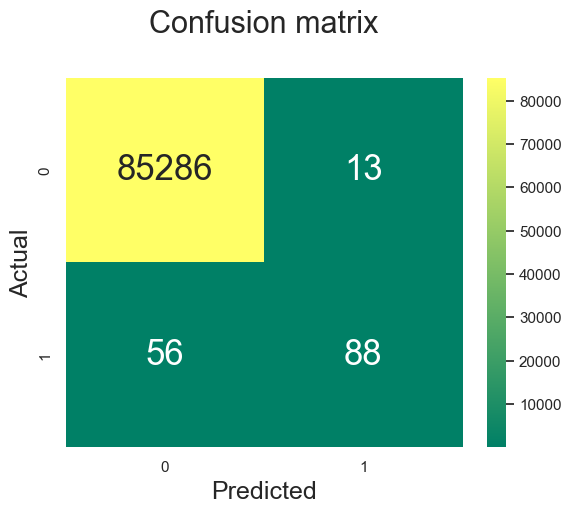

In [55]:
# Heatmap for Confusion Matrix
p = sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, annot_kws={"size": 25}, cmap="summer" ,fmt='g')

plt.title('Confusion matrix', y=1.1, fontsize = 22)
plt.ylabel('Actual',fontsize = 18)
plt.xlabel('Predicted',fontsize = 18)

plt.show()

#### We already know that we have 144 fraud transaction in our test dataset, but our model predicted only 88 fraud transaction. So the real accuracy of our model is ${88}\over{144}$

In [56]:
88/144

0.6111111111111112

So, **61.11%** is the real accuracy of our model, which is nothing but the **Recall Score**. So we have the emphasis on Recall score and F1 score to measure the performance of our model, not the accuracy.

## Receiver Operating Characteristics (ROC)

In [57]:
metrics.roc_auc_score(y_test , y_pred) 

0.805479353020942

In [58]:
y_pred_proba = logreg.predict_proba(X_test)
y_pred_proba

array([[9.99549115e-01, 4.50885233e-04],
       [9.99867302e-01, 1.32697762e-04],
       [9.99800822e-01, 1.99178082e-04],
       ...,
       [9.99654918e-01, 3.45081631e-04],
       [9.99606747e-01, 3.93253276e-04],
       [9.99803917e-01, 1.96083331e-04]])

AUC -  0.805479353020942 



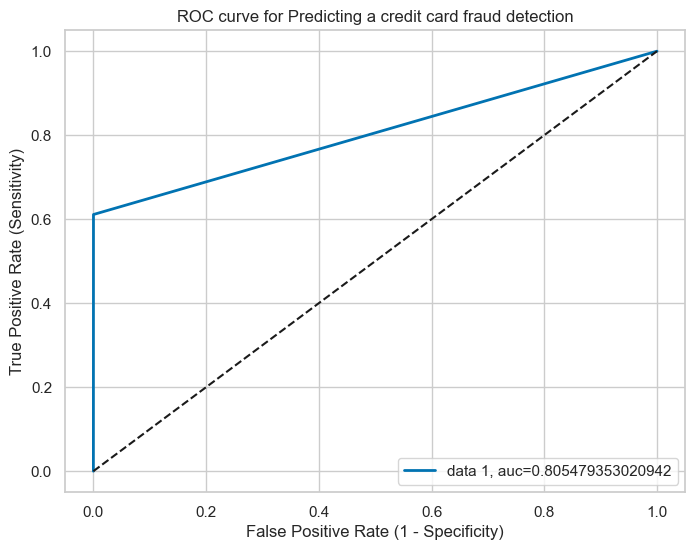

In [59]:
# plot ROC Curve

plt.figure(figsize=(8,6))

fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred)

auc = metrics.roc_auc_score(y_test, y_pred)
print("AUC - ",auc,"\n")

plt.plot(fpr,tpr,linewidth=2, label="data 1, auc="+str(auc))
plt.legend(loc=4)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12
plt.title('ROC curve for Predicting a credit card fraud detection')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

f1=0.718


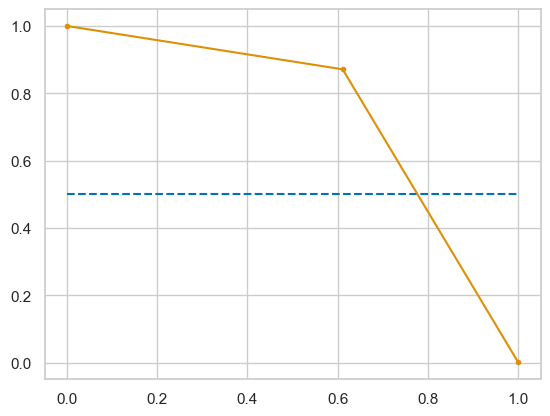

In [60]:
# calculate precision-recall curve
precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred)

f1 = metrics.f1_score(y_test, y_pred)

print('f1=%.3f' % (f1))

# plot no skill
plt.plot([0, 1], [0.5, 0.5], linestyle='--')

# plot the roc curve for the model
plt.plot(recall, precision, marker='.')


plt.show()

# Class Imbalance

## Import imbalace technique algorithims

In [61]:
# Import imbalace technique algorithims
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score, classification_report
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler

## Logistic Regression with Random Undersampling technique

In [62]:
from collections import Counter # counter takes values returns value_counts dictionary
from sklearn.datasets import make_classification

In [63]:
print('Original dataset shape %s' % Counter(y_train))

# Undersampling only on train
rus = RandomUnderSampler(random_state=42)
X_train_rus, y_train_rus = rus.fit_resample(X_train, y_train)

print('Resampled dataset shape %s' % Counter(y_train_rus))

Original dataset shape Counter({0: 199016, 1: 348})
Resampled dataset shape Counter({0: 348, 1: 348})


In [64]:
# Undersampling with Logistic Regression
logreg = LogisticRegression()
logreg.fit(X_train_rus, y_train_rus)

y_pred_rus = logreg.predict(X_test)

In [65]:
print('Accuracy :{0:0.5f}'.format(metrics.accuracy_score(y_pred_rus , y_test))) 
print('AUC : {0:0.5f}'.format(metrics.roc_auc_score(y_test , y_pred_rus)))
print('Precision : {0:0.5f}'.format(metrics.precision_score(y_test , y_pred_rus)))
print('Recall : {0:0.5f}'.format(metrics.recall_score(y_test , y_pred_rus)))
print('F1 : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_rus)))

Accuracy :0.97406
AUC : 0.94195
Precision : 0.05613
Recall : 0.90972
F1 : 0.10573


AUC -  0.9419477123608327 



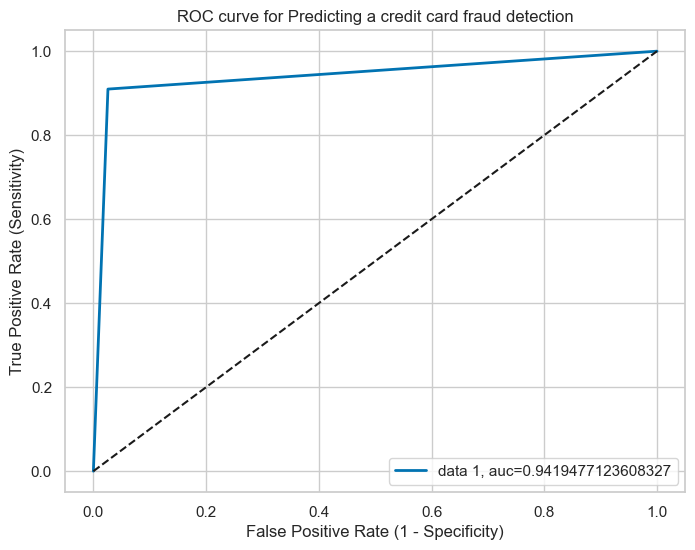

In [66]:
# plot ROC Curve

plt.figure(figsize=(8,6))

fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred_rus)

auc = metrics.roc_auc_score(y_test, y_pred_rus)
print("AUC - ",auc,"\n")

plt.plot(fpr,tpr,linewidth=2, label="data 1, auc="+str(auc))
plt.legend(loc=4)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12
plt.title('ROC curve for Predicting a credit card fraud detection')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

f1=0.106


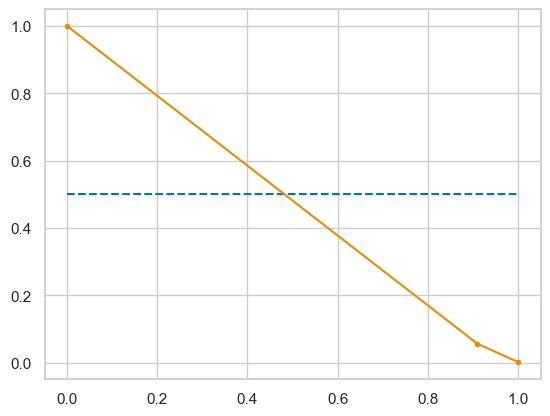

In [67]:
# calculate precision-recall curve
precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_rus)

# calculate F1 score
f1 = metrics.f1_score(y_test, y_pred_rus)
print('f1=%.3f' % (f1))

# plot no skill
plt.plot([0, 1], [0.5, 0.5], linestyle='--')

# plot the roc curve for the model
plt.plot(recall, precision, marker='.')

# show the plot
plt.show()

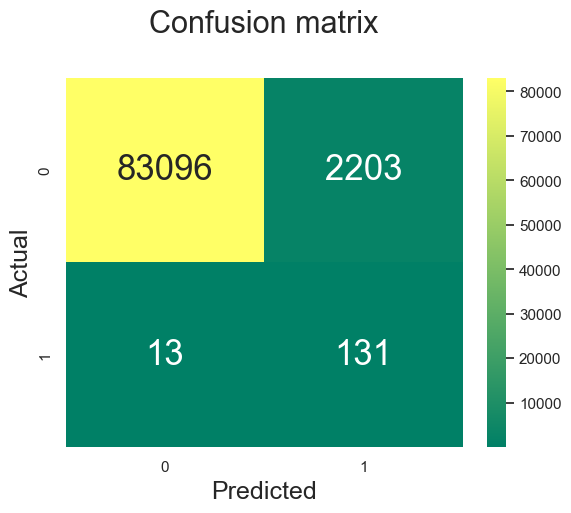

In [68]:
# Heatmap for Confusion Matrix

cnf_matrix = metrics.confusion_matrix(y_test , y_pred_rus)
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, annot_kws={"size": 25}, cmap="summer" ,fmt='g')

plt.title('Confusion matrix', y=1.1, fontsize = 22)
plt.xlabel('Predicted',fontsize = 18)
plt.ylabel('Actual',fontsize = 18)

# ax.xaxis.set_ticklabels(['Genuine', 'Fraud']); 
# ax.yaxis.set_ticklabels(['Genuine', 'Fraud']);

plt.show()

## Logistic Regression with Random Oversampling technique

In [69]:
from imblearn.over_sampling import RandomOverSampler

In [70]:
print('Original dataset shape %s' % Counter(y_train))

ros = RandomOverSampler(random_state=42)
X_train_ros, y_train_ros = ros.fit_resample(X_train, y_train)

print('Resampled dataset shape %s' % Counter(y_train_ros))

Original dataset shape Counter({0: 199016, 1: 348})
Resampled dataset shape Counter({0: 199016, 1: 199016})


In [71]:
# Oversampling with Logistic Regression
logreg = LogisticRegression()
logreg.fit(X_train_ros, y_train_ros)

y_pred_ros = logreg.predict(X_test)

In [72]:
print('Accuracy :{0:0.5f}'.format(metrics.accuracy_score(y_test , y_pred_ros))) 
print('AUC : {0:0.5f}'.format(metrics.roc_auc_score(y_test , y_pred_ros)))
print('Precision : {0:0.5f}'.format(metrics.precision_score(y_test , y_pred_ros)))
print('Recall : {0:0.5f}'.format(metrics.recall_score(y_test , y_pred_ros)))
print('F1 : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_ros)))

Accuracy :0.97802
AUC : 0.93700
Precision : 0.06476
Recall : 0.89583
F1 : 0.12079


AUC -  0.9369962572832038 



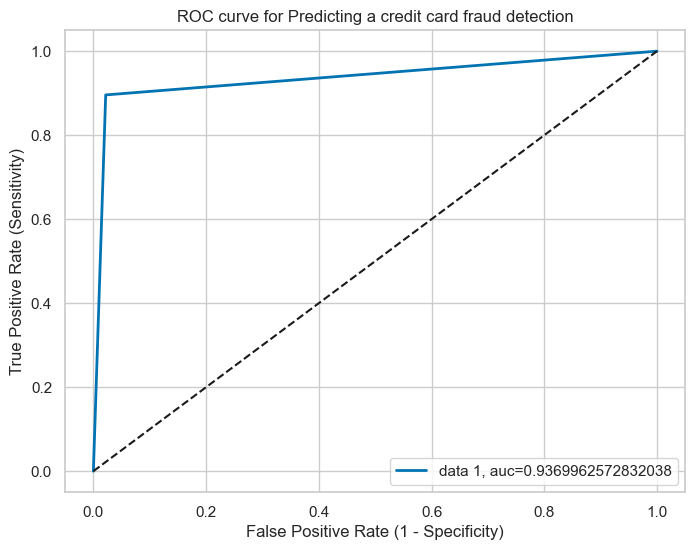

In [73]:
# plot ROC Curve

plt.figure(figsize=(8,6))

fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred_ros)

auc = metrics.roc_auc_score(y_test, y_pred_ros)
print("AUC - ",auc,"\n")

plt.plot(fpr,tpr,linewidth=2, label="data 1, auc="+str(auc))
plt.legend(loc=4)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12
plt.title('ROC curve for Predicting a credit card fraud detection')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

f1=0.121


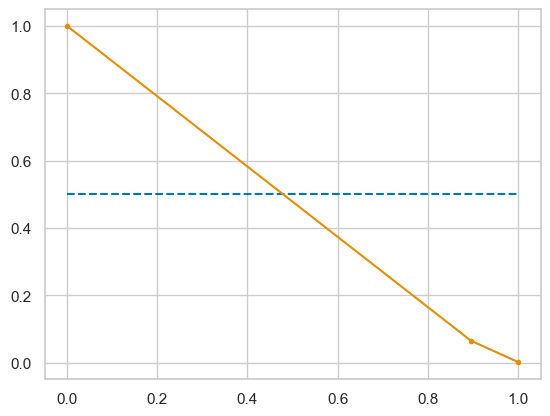

In [74]:
# calculate precision-recall curve
precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_ros)

# calculate F1 score
f1 = metrics.f1_score(y_test, y_pred_ros)
print('f1=%.3f' % (f1))

# plot no skill
plt.plot([0, 1], [0.5, 0.5], linestyle='--')

# plot the roc curve for the model
plt.plot(recall, precision, marker='.')

# show the plot
plt.show()

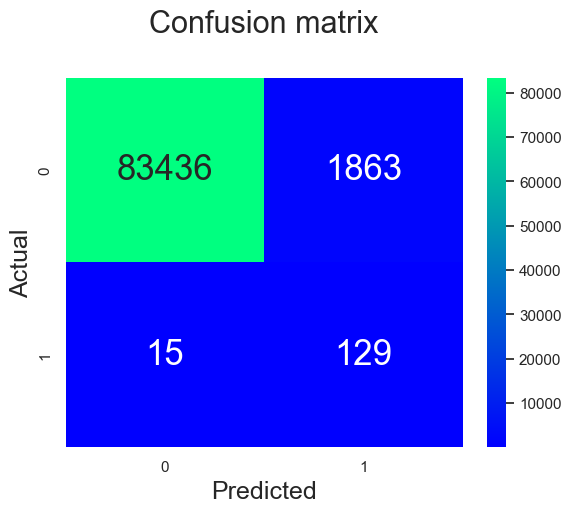

In [75]:
# Heatmap for Confusion Matrix

cnf_matrix = metrics.confusion_matrix(y_test , y_pred_ros)
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, annot_kws={"size": 25}, cmap="winter" ,fmt='g')

plt.title('Confusion matrix', y=1.1, fontsize = 22)
plt.xlabel('Predicted',fontsize = 18)
plt.ylabel('Actual',fontsize = 18)

# ax.xaxis.set_ticklabels(['Genuine', 'Fraud']); 
# ax.yaxis.set_ticklabels(['Genuine', 'Fraud']);

plt.show()

 ## Logistic Regression with SMOTE data

In [76]:
from imblearn.over_sampling import SMOTE, ADASYN

In [77]:
print('Original dataset shape %s' % Counter(y_train))

smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

print('Resampled dataset shape %s' % Counter(y_train_smote))

Original dataset shape Counter({0: 199016, 1: 348})
Resampled dataset shape Counter({0: 199016, 1: 199016})


In [78]:
# SMOTE Sampling with Logistic Regression
logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_train_smote, y_train_smote)

y_pred_smote = logreg.predict(X_test)

In [79]:
print('Accuracy :{0:0.5f}'.format(metrics.accuracy_score(y_test , y_pred_smote))) 
print('AUC : {0:0.5f}'.format(metrics.roc_auc_score(y_test , y_pred_smote)))
print('Precision : {0:0.5f}'.format(metrics.precision_score(y_test , y_pred_smote)))
print('Recall : {0:0.5f}'.format(metrics.recall_score(y_test , y_pred_smote)))
print('F1 : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_smote)))

Accuracy :0.97602
AUC : 0.93599
Precision : 0.05964
Recall : 0.89583
F1 : 0.11183


AUC -  0.9359939008663642 



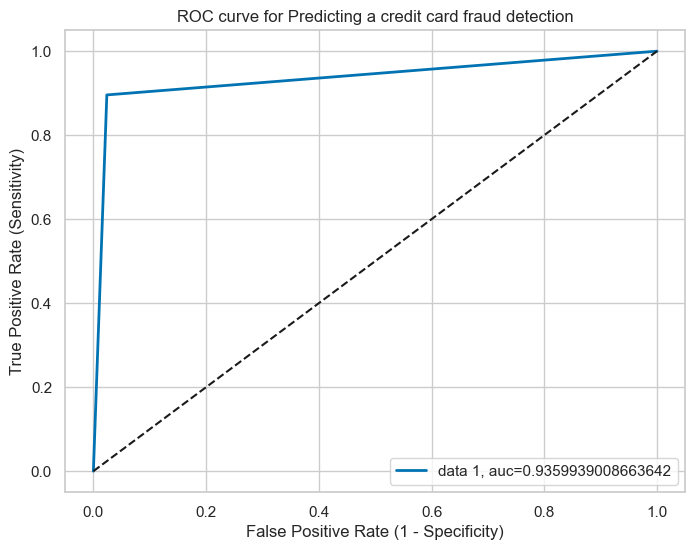

In [80]:
# plot ROC Curve

plt.figure(figsize=(8,6))

fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred_smote)

auc = metrics.roc_auc_score(y_test, y_pred_smote)
print("AUC - ",auc,"\n")

plt.plot(fpr,tpr,linewidth=2, label="data 1, auc="+str(auc))
plt.legend(loc=4)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12
plt.title('ROC curve for Predicting a credit card fraud detection')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

f1=0.112


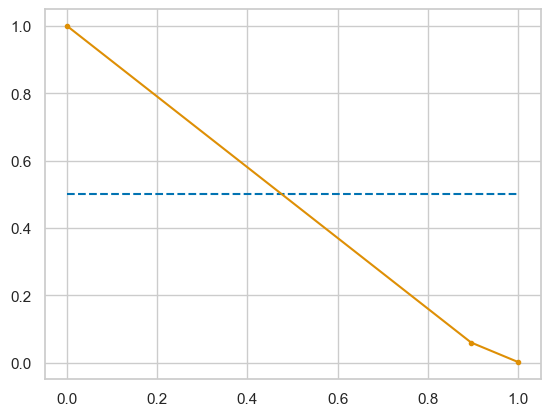

In [81]:
# calculate precision-recall curve
precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_smote)

# calculate F1 score
f1 = metrics.f1_score(y_test, y_pred_smote)
print('f1=%.3f' % (f1))

# plot no skill
plt.plot([0, 1], [0.5, 0.5], linestyle='--')

# plot the roc curve for the model
plt.plot(recall, precision, marker='.')

# show the plot
plt.show()

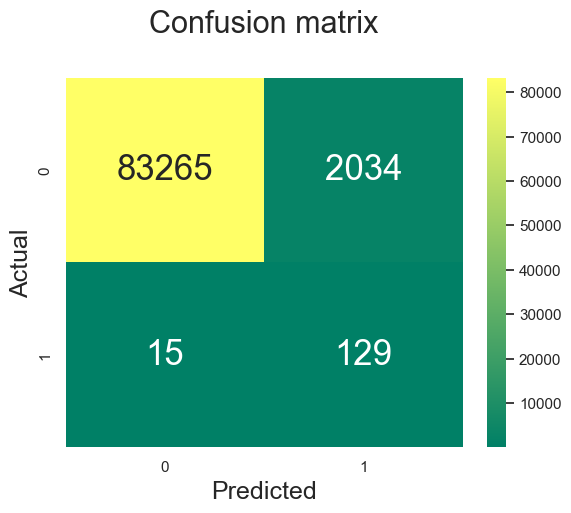

In [82]:
# Heatmap for Confusion Matrix
cnf_matrix = metrics.confusion_matrix(y_test , y_pred_smote)
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, annot_kws={"size": 25}, cmap="summer" ,fmt='g')

plt.title('Confusion matrix', y=1.1, fontsize = 22)
plt.xlabel('Predicted',fontsize = 18)
plt.ylabel('Actual',fontsize = 18)

# ax.xaxis.set_ticklabels(['Genuine', 'Fraud']); 
# ax.yaxis.set_ticklabels(['Genuine', 'Fraud']);

plt.show()

## Logistic Regression with ADASYN data

In [83]:
print('Original dataset shape %s' % Counter(y_train))

adasyn = ADASYN(random_state=42)

X_train_adasyn, y_train_adasyn = adasyn.fit_resample(X_train, y_train)
print('Resampled dataset shape %s' % Counter(y_train_adasyn))

Original dataset shape Counter({0: 199016, 1: 348})
Resampled dataset shape Counter({0: 199016, 1: 199012})


In [84]:
#  ADASYN Sampling with Logistic Regression
logreg = LogisticRegression()
logreg.fit(X_train_adasyn, y_train_adasyn)

y_pred_adasyn = logreg.predict(X_test)

In [85]:
print('Accuracy :{0:0.5f}'.format(metrics.accuracy_score(y_pred , y_pred_adasyn))) 
print('AUC : {0:0.5f}'.format(metrics.roc_auc_score(y_test , y_pred_adasyn)))
print('Precision : {0:0.5f}'.format(metrics.precision_score(y_test , y_pred_adasyn)))
print('Recall : {0:0.5f}'.format(metrics.recall_score(y_test , y_pred_adasyn)))
print('F1 : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_adasyn)))

Accuracy :0.91831
AUC : 0.93151
Precision : 0.01921
Recall : 0.94444
F1 : 0.03765


AUC -  0.9315124835382986 



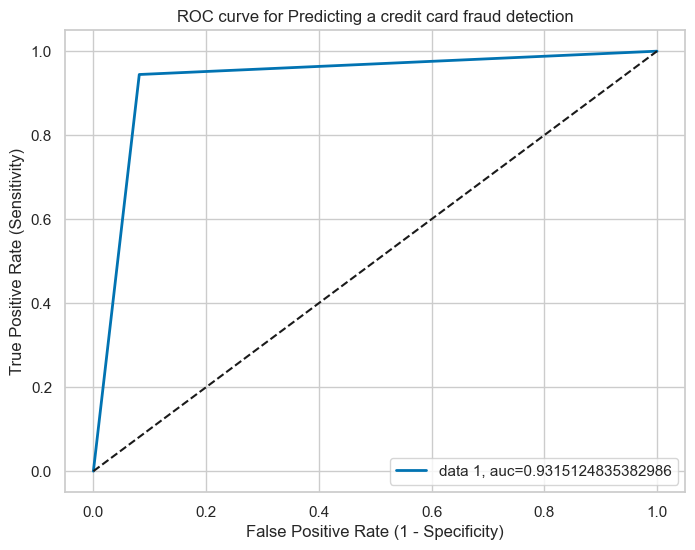

In [86]:
# plot ROC Curve

plt.figure(figsize=(8,6))

fpr, tpr, thresholds = metrics.roc_curve(y_test, y_pred_adasyn)

auc = metrics.roc_auc_score(y_test, y_pred_adasyn)
print("AUC - ",auc,"\n")

plt.plot(fpr,tpr,linewidth=2, label="data 1, auc="+str(auc))
plt.legend(loc=4)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12
plt.title('ROC curve for Predicting a credit card fraud detection')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

f1=0.038


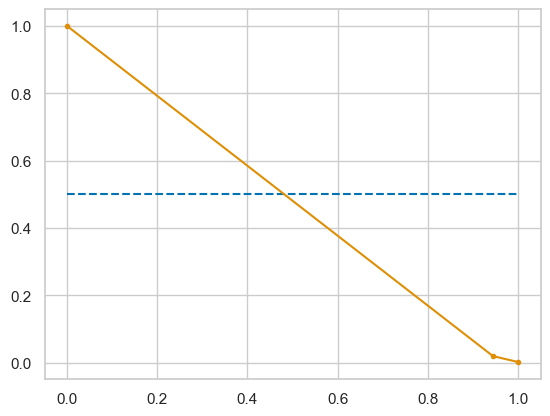

In [87]:
# calculate precision-recall curve
precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_adasyn)

# calculate F1 score
f1 = metrics.f1_score(y_test, y_pred_adasyn)
print('f1=%.3f' % (f1))

# plot no skill
plt.plot([0, 1], [0.5, 0.5], linestyle='--')

# plot the roc curve for the model
plt.plot(recall, precision, marker='.')

# show the plot
plt.show()

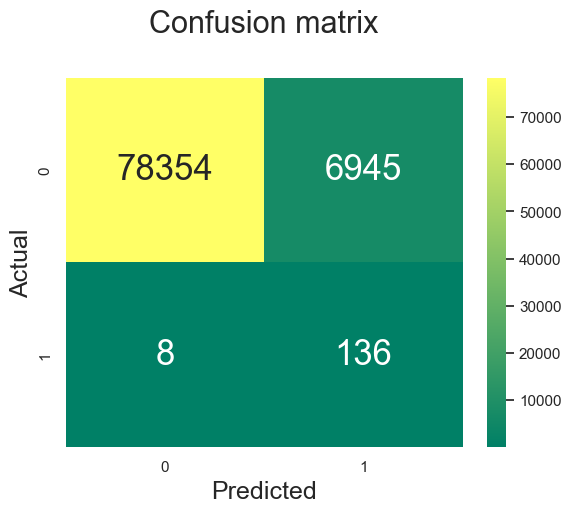

In [88]:
# Heatmap for Confusion Matrix

cnf_matrix = metrics.confusion_matrix(y_test , y_pred_adasyn)
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, annot_kws={"size": 25}, cmap="summer" ,fmt='g')

plt.title('Confusion matrix', y=1.1, fontsize = 22)
plt.xlabel('Predicted',fontsize = 18)
plt.ylabel('Actual',fontsize = 18)

# ax.xaxis.set_ticklabels(['Genuine', 'Fraud']);a 
# ax.yaxis.set_ticklabels(['Genuine', 'Fraud']);

plt.show()

## **Principal Component Analysis**

In [89]:
from sklearn.decomposition import PCA

In [90]:
X_reduced_pca_im = PCA(n_components=2, random_state=42).fit_transform(X_train)

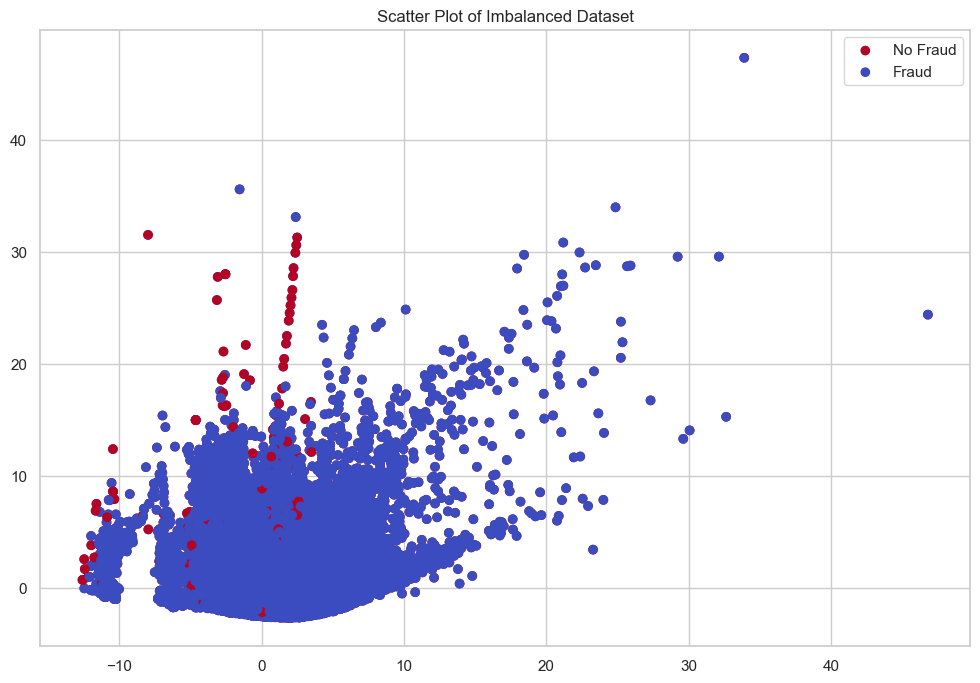

In [91]:
# Generate and plot a synthetic imbalanced classification dataset
plt.figure(figsize=(12,8))

plt.scatter(X_reduced_pca_im[:,0], X_reduced_pca_im[:,1], c=(y_train == 0), label='No Fraud', cmap='coolwarm', linewidths=1)
plt.scatter(X_reduced_pca_im[:,0], X_reduced_pca_im[:,1], c=(y_train == 1), label='Fraud', cmap='coolwarm', linewidths=1)

plt.title("Scatter Plot of Imbalanced Dataset")
plt.legend()
plt.show()

In [92]:
X_reduced_pca = PCA(n_components=2, random_state=42).fit_transform(X_train_smote)

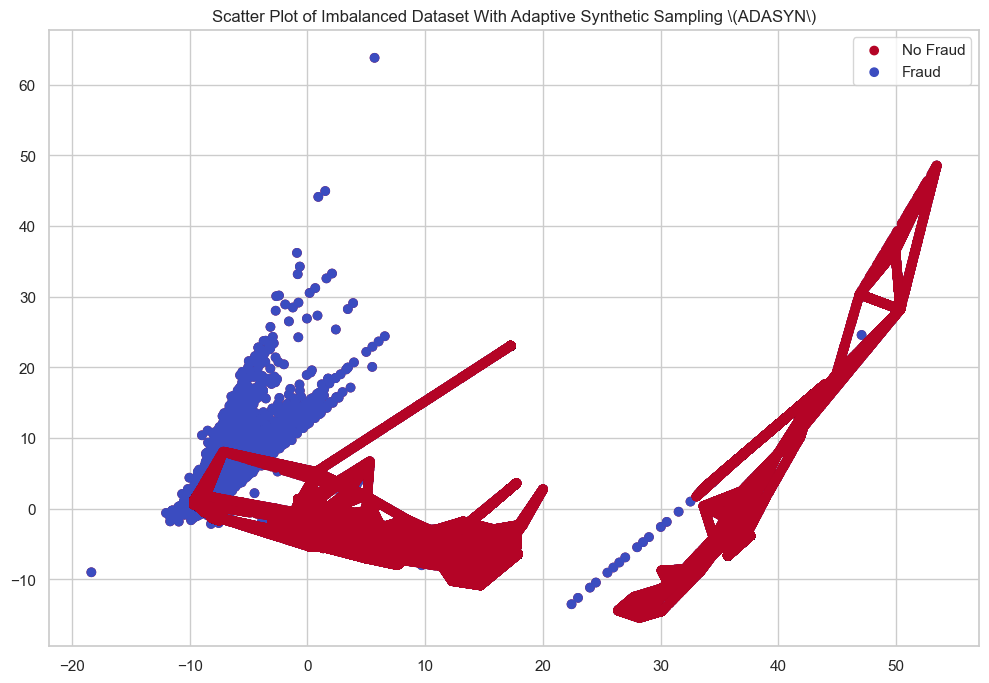

In [93]:
# Oversample and plot imbalanced dataset with ADASYN
plt.figure(figsize=(12,8))

plt.scatter(X_reduced_pca[:,0], X_reduced_pca[:,1], c=(y_train_smote == 0), cmap='coolwarm', label='No Fraud', linewidths=1)
plt.scatter(X_reduced_pca[:,0], X_reduced_pca[:,1], c=(y_train_smote == 1), cmap='coolwarm', label='Fraud', linewidths=1)

plt.title("Scatter Plot of Imbalanced Dataset With Adaptive Synthetic Sampling \(ADASYN\)")
plt.legend()
plt.show()

# Building different models with different balanced datasets

In [94]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB

In [95]:
names_lst = []

# Empty list to capture performance matrix for train set
aucs_train_lst = []
accuracy_train_lst = []
precision_train_lst = []
recall_train_lst = []
f1_train_lst = []

# Empty list to capture performance matrix for test set
aucs_test_lst = []
accuracy_test_lst = []
precision_test_lst = []
recall_test_lst = []
f1_test_lst = []

# Function for model building and performance measure

def build_measure_model(models):
    plt.figure(figsize=(12,6))

    for name, model, X_train, y_train, X_test, y_test in models:
        
        names_lst.append(name)

        # Build model
        model.fit(X_train, y_train)
        
        # Predict
        y_train_pred = model.predict(X_train)
        y_test_pred = model.predict(X_test)

        # calculate accuracy
        Accuracy_train = metrics.accuracy_score(y_train, y_train_pred)
        accuracy_train_lst.append(Accuracy_train)
        
        Accuracy_test = metrics.accuracy_score(y_test, y_test_pred)
        accuracy_test_lst.append(Accuracy_test)

        # calculate auc
        Aucs_train = metrics.roc_auc_score(y_train, y_train_pred)
        aucs_train_lst.append(Aucs_train)
        
        Aucs_test = metrics.roc_auc_score(y_test , y_test_pred)
        aucs_test_lst.append(Aucs_test)

        # calculate precision
        PrecisionScore_train = metrics.precision_score(y_train , y_train_pred)
        precision_train_lst.append(PrecisionScore_train)
        
        PrecisionScore_test = metrics.precision_score(y_test , y_test_pred)
        precision_test_lst.append(PrecisionScore_test)

        # calculate recall
        RecallScore_train = metrics.recall_score(y_train , y_train_pred)
        recall_train_lst.append(RecallScore_train)
        
        RecallScore_test = metrics.recall_score(y_test , y_test_pred)
        recall_test_lst.append(RecallScore_test)

        # calculate f1 score
        F1Score_train = metrics.f1_score(y_train , y_train_pred)
        f1_train_lst.append(F1Score_train)
        
        F1Score_test = metrics.f1_score(y_test , y_test_pred)
        f1_test_lst.append(F1Score_test)

        #print('F1 Score of '+ name +' model : {0:0.5f}'.format(F1Score_test))

        # draw confusion matrix
        cnf_matrix = metrics.confusion_matrix(y_test , y_test_pred)

        print("Model Name :", name)
        
        print('Train Accuracy :{0:0.5f}'.format(Accuracy_train)) 
        print('Test Accuracy :{0:0.5f}'.format(Accuracy_test))
        
        print('Train AUC : {0:0.5f}'.format(Aucs_train))
        print('Test AUC : {0:0.5f}'.format(Aucs_test))
        
        print('Train Precision : {0:0.5f}'.format(PrecisionScore_train))
        print('Test Precision : {0:0.5f}'.format(PrecisionScore_test))
        
        print('Train Recall : {0:0.5f}'.format(RecallScore_train))
        print('Test Recall : {0:0.5f}'.format(RecallScore_test))
        
        print('Train F1 : {0:0.5f}'.format(F1Score_train))
        print('Test F1 : {0:0.5f}'.format(F1Score_test))
        
        print('Confusion Matrix : \n', cnf_matrix)
        print("\n")


        # plot ROC Curve
        fpr, tpr, thresholds = metrics.roc_curve(y_test, y_test_pred)
        auc = metrics.roc_auc_score(y_test, y_test_pred)
        plt.plot(fpr,tpr,linewidth=2, label=name + ", auc="+str(auc))
    
        #---------- For loops ends here--------#


    plt.legend(loc=4)
    plt.plot([0,1], [0,1], 'k--' )
    plt.rcParams['font.size'] = 12
    plt.title('ROC curve for Predicting a credit card fraud detection')
    plt.xlabel('False Positive Rate (1 - Specificity)')
    plt.ylabel('True Positive Rate (Sensitivity)')
    plt.show()

### Logistic Regression (LR)

Model Name : LR imbalance
Train Accuracy :0.99916
Test Accuracy :0.99920
Train AUC : 0.80452
Test AUC : 0.80549
Train Precision : 0.87243
Test Precision : 0.88000
Train Recall : 0.60920
Test Recall : 0.61111
Train F1 : 0.71743
Test F1 : 0.72131
Confusion Matrix : 
 [[85287    12]
 [   56    88]]


Model Name : LR Undersampling
Train Accuracy :0.94971
Test Accuracy :0.97252
Train AUC : 0.94971
Test AUC : 0.94117
Train Precision : 0.97568
Test Precision : 0.05312
Train Recall : 0.92241
Test Recall : 0.90972
Train F1 : 0.94830
Test F1 : 0.10038
Confusion Matrix : 
 [[82964  2335]
 [   13   131]]


Model Name : LR Oversampling
Train Accuracy :0.95325
Test Accuracy :0.97799
Train AUC : 0.95325
Test AUC : 0.93698
Train Precision : 0.97630
Test Precision : 0.06466
Train Recall : 0.92906
Test Recall : 0.89583
Train F1 : 0.95209
Test F1 : 0.12062
Confusion Matrix : 
 [[83433  1866]
 [   15   129]]


Model Name : LR SMOTE
Train Accuracy :0.94666
Test Accuracy :0.97604
Train AUC : 0.94666
Test AU

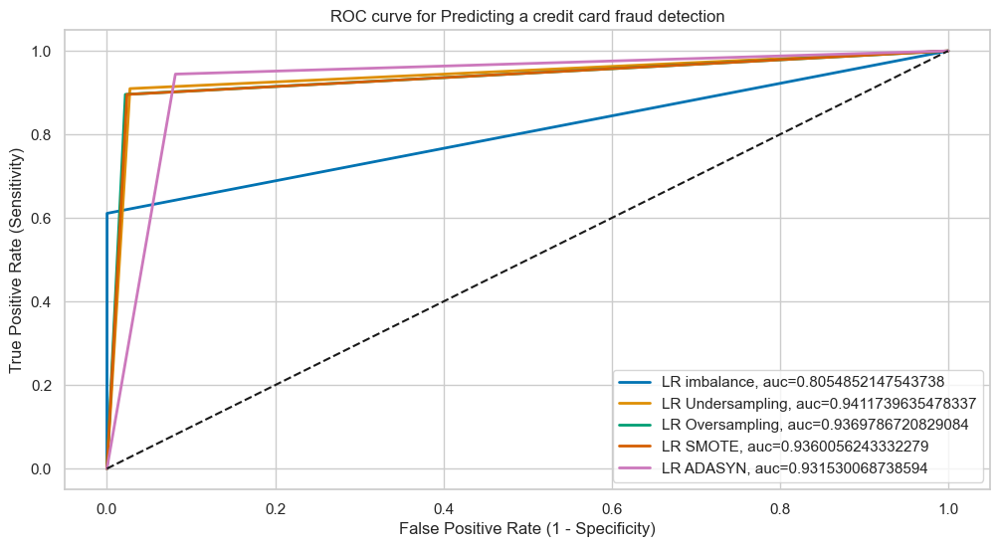

In [96]:
#------------------ Logistic Regression (LR) ------------------#
LRmodels = []

LRmodels.append(('LR imbalance', LogisticRegression(solver='liblinear', multi_class='ovr'), X_train,y_train,X_test,y_test))
LRmodels.append(('LR Undersampling', LogisticRegression(solver='liblinear', multi_class='ovr'),X_train_rus,y_train_rus,X_test,y_test))
LRmodels.append(('LR Oversampling', LogisticRegression(solver='liblinear', multi_class='ovr'),X_train_ros,y_train_ros,X_test,y_test))
LRmodels.append(('LR SMOTE', LogisticRegression(solver='liblinear', multi_class='ovr'),X_train_smote,y_train_smote,X_test,y_test))
LRmodels.append(('LR ADASYN', LogisticRegression(solver='liblinear', multi_class='ovr'),X_train_adasyn,y_train_adasyn,X_test,y_test))

# Call function to create model and measure its performance
build_measure_model(LRmodels)

### Decision Tree (DT)

Model Name : DT imbalance
Train Accuracy :1.00000
Test Accuracy :0.99910
Train AUC : 1.00000
Test AUC : 0.89209
Train Precision : 1.00000
Test Precision : 0.71069
Train Recall : 1.00000
Test Recall : 0.78472
Train F1 : 1.00000
Test F1 : 0.74587
Confusion Matrix : 
 [[85253    46]
 [   31   113]]


Model Name : DT Undersampling
Train Accuracy :1.00000
Test Accuracy :0.89331
Train AUC : 1.00000
Test AUC : 0.89110
Train Precision : 1.00000
Test Precision : 0.01387
Train Recall : 1.00000
Test Recall : 0.88889
Train F1 : 1.00000
Test F1 : 0.02732
Confusion Matrix : 
 [[76199  9100]
 [   16   128]]


Model Name : DT Oversampling
Train Accuracy :1.00000
Test Accuracy :0.99916
Train AUC : 1.00000
Test AUC : 0.84359
Train Precision : 1.00000
Test Precision : 0.78571
Train Recall : 1.00000
Test Recall : 0.68750
Train F1 : 1.00000
Test F1 : 0.73333
Confusion Matrix : 
 [[85272    27]
 [   45    99]]


Model Name : DT SMOTE
Train Accuracy :1.00000
Test Accuracy :0.99788
Train AUC : 1.00000
Test AU

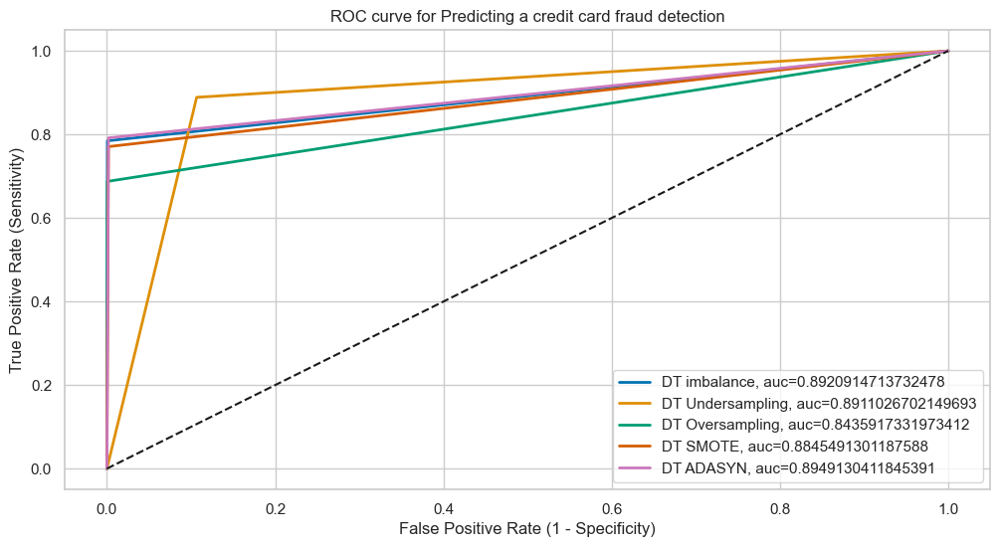

In [97]:
#-----------------Decision Tree (DT)------------------#
DTmodels = []

dt = DecisionTreeClassifier()

DTmodels.append(('DT imbalance', dt,X_train,y_train,X_test,y_test))
DTmodels.append(('DT Undersampling', dt,X_train_rus,y_train_rus,X_test,y_test))
DTmodels.append(('DT Oversampling', dt,X_train_ros,y_train_ros,X_test,y_test))
DTmodels.append(('DT SMOTE', dt,X_train_smote,y_train_smote,X_test,y_test))
DTmodels.append(('DT ADASYN', dt,X_train_adasyn,y_train_adasyn,X_test,y_test))

# Call function to create model and measure its performance
build_measure_model(DTmodels)

### Random Forest (RF)

Model Name : RF imbalance
Train Accuracy :1.00000
Test Accuracy :0.99954
Train AUC : 1.00000
Test AUC : 0.88885
Train Precision : 1.00000
Test Precision : 0.94118
Train Recall : 1.00000
Test Recall : 0.77778
Train F1 : 1.00000
Test F1 : 0.85171
Confusion Matrix : 
 [[85292     7]
 [   32   112]]


Model Name : RF Undersampling
Train Accuracy :1.00000
Test Accuracy :0.96939
Train AUC : 1.00000
Test AUC : 0.92574
Train Precision : 1.00000
Test Precision : 0.04661
Train Recall : 1.00000
Test Recall : 0.88194
Train F1 : 1.00000
Test F1 : 0.08853
Confusion Matrix : 
 [[82701  2598]
 [   17   127]]


Model Name : RF Oversampling
Train Accuracy :1.00000
Test Accuracy :0.99956
Train AUC : 1.00000
Test AUC : 0.89232
Train Precision : 1.00000
Test Precision : 0.94167
Train Recall : 1.00000
Test Recall : 0.78472
Train F1 : 1.00000
Test F1 : 0.85606
Confusion Matrix : 
 [[85292     7]
 [   31   113]]


Model Name : RF SMOTE
Train Accuracy :1.00000
Test Accuracy :0.99953
Train AUC : 1.00000
Test AU

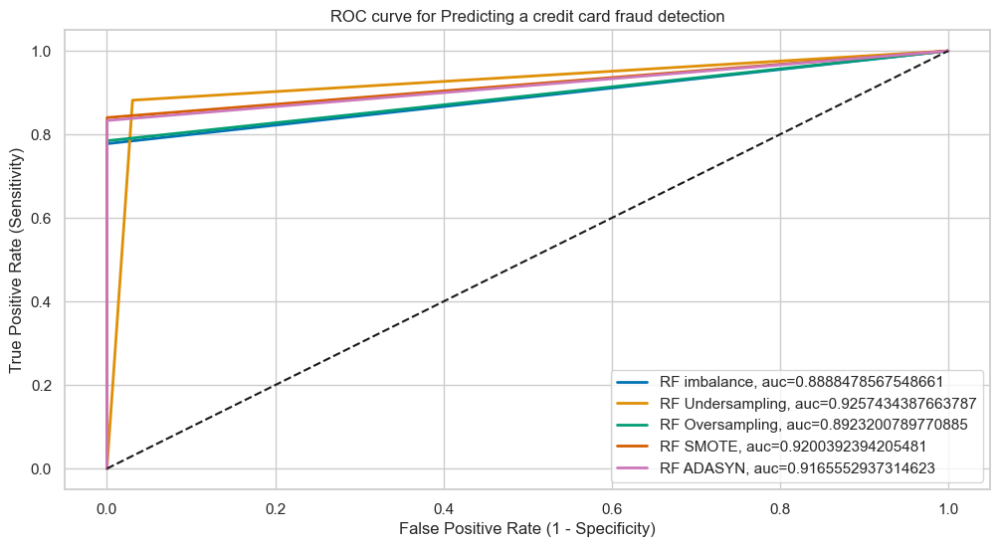

In [98]:
#-----------------Random Forest (RF) ------------------#
RFmodels = []
rf_params = dict(n_estimators=50, max_depth=8, random_state=42, n_jobs=-1)
RFmodels.append(('RF imbalance', RandomForestClassifier(),X_train,y_train,X_test,y_test))
RFmodels.append(('RF Undersampling', RandomForestClassifier(),X_train_rus,y_train_rus,X_test,y_test))
RFmodels.append(('RF Oversampling', RandomForestClassifier(),X_train_ros,y_train_ros,X_test,y_test))
RFmodels.append(('RF SMOTE', RandomForestClassifier(),X_train_smote,y_train_smote,X_test,y_test))
RFmodels.append(('RF ADASYN', RandomForestClassifier(),X_train_adasyn,y_train_adasyn,X_test,y_test))

# Call function to create model and measure its performance
build_measure_model(RFmodels)

### K-Nearest Neighbors (KNN)

Model Name : KNN imbalance
Train Accuracy :0.99954
Test Accuracy :0.99953
Train AUC : 0.88790
Test AUC : 0.89577
Train Precision : 0.95406
Test Precision : 0.91935
Train Recall : 0.77586
Test Recall : 0.79167
Train F1 : 0.85578
Test F1 : 0.85075
Confusion Matrix : 
 [[85289    10]
 [   30   114]]


Model Name : KNN Undersampling
Train Accuracy :0.94397
Test Accuracy :0.97259
Train AUC : 0.94397
Test AUC : 0.93774
Train Precision : 0.97833
Test Precision : 0.05289
Train Recall : 0.90805
Test Recall : 0.90278
Train F1 : 0.94188
Test F1 : 0.09992
Confusion Matrix : 
 [[82971  2328]
 [   14   130]]


Model Name : KNN Oversampling
Train Accuracy :0.99979
Test Accuracy :0.99912
Train AUC : 0.99979
Test AUC : 0.92330
Train Precision : 0.99959
Test Precision : 0.69714
Train Recall : 1.00000
Test Recall : 0.84722
Train F1 : 0.99979
Test F1 : 0.76489
Confusion Matrix : 
 [[85246    53]
 [   22   122]]


Model Name : KNN SMOTE
Train Accuracy :0.99950
Test Accuracy :0.99819
Train AUC : 0.99950
Tes

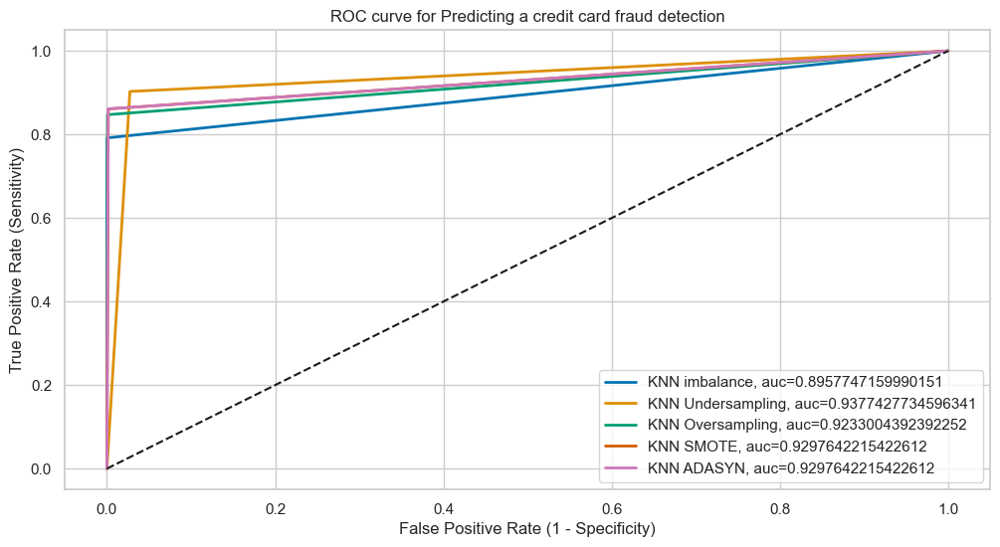

In [99]:
# #------------------ K-Nearest Neighbors (KNN) ------------------#
KNNmodels = []
knn_params = {'n_neighbors': 5, 'weights': 'distance', 'algorithm': 'auto', 'n_jobs': -1}

KNNmodels.append(('KNN imbalance', KNeighborsClassifier(),X_train,y_train,X_test,y_test))
KNNmodels.append(('KNN Undersampling', KNeighborsClassifier(),X_train_rus,y_train_rus,X_test,y_test))
KNNmodels.append(('KNN Oversampling', KNeighborsClassifier(),X_train_ros,y_train_ros,X_test,y_test))
KNNmodels.append(('KNN SMOTE', KNeighborsClassifier(),X_train_smote,y_train_smote,X_test,y_test))
KNNmodels.append(('KNN ADASYN', KNeighborsClassifier(),X_train_adasyn,y_train_adasyn,X_test,y_test))

# Call function to create model and measure its performance
build_measure_model(KNNmodels)

### Support Vector Machines (SVM)

In [ ]:
#------------------ Support Vector Machines (SVM) ------------------#
from sklearn.svm import SVC
SVMmodels = [
    ('SVM imbalance', SVC(gamma='auto', probability=True, random_state=42), X_train, y_train, X_test, y_test),
    ('SVM Undersampling', SVC(gamma='auto', probability=True, random_state=42), X_train_rus, y_train_rus, X_test, y_test),
    ('SVM Oversampling', SVC(gamma='auto', probability=True, random_state=42), X_train_ros, y_train_ros, X_test, y_test),
    ('SVM SMOTE', SVC(gamma='auto', probability=True, random_state=42), X_train_smote, y_train_smote, X_test, y_test),
    ('SVM ADASYN', SVC(gamma='auto', probability=True, random_state=42), X_train_adasyn, y_train_adasyn, X_test, y_test)
]

#  Build and evaluate models
build_measure_model(SVMmodels)


### Naive Bayes (NB)

In [ ]:
# #------------------ Gaussian Naive Bayes (NB) ------------------#
from sklearn.naive_bayes import GaussianNB

NBmodels = [
    ('NB imbalance', GaussianNB(), X_train, y_train, X_test, y_test),
    ('NB Undersampling', GaussianNB(), X_train_rus, y_train_rus, X_test, y_test),
    ('NB Oversampling', GaussianNB(), X_train_ros, y_train_ros, X_test, y_test),
    ('NB SMOTE', GaussianNB(), X_train_smote, y_train_smote, X_test, y_test),
    ('NB ADASYN', GaussianNB(), X_train_adasyn, y_train_adasyn, X_test, y_test)
]

#  Build and evaluate models
build_measure_model(NBmodels)


### Performance measures of various classifiers

In [ ]:
data = {'Model':names_lst,
       #'Accuracy_Train':accuracy_train_lst,

       'Accuracy_Test':accuracy_test_lst,

       #'AUC_Train':aucs_train_lst,

       'AUC_Test':aucs_test_lst,

       #'PrecisionScore_Train':precision_train_lst,

       'PrecisionScore_Test':precision_test_lst,

       #'RecallScore_Train':recall_train_lst,

       'RecallScore_Test':recall_test_lst,

       #'F1Score_Train':f1_train_lst,
       
       'F1Score_Test':f1_test_lst}

print("Performance measures of various classifiers: \n")
performance_df = pd.DataFrame(data) 

performance_df = performance_df.sort_values(['F1Score_Test','RecallScore_Test','AUC_Test'],ascending=False)

# Grid Search

In [ ]:
# Use GridSearchCV to find the best parameters.
from sklearn.model_selection import GridSearchCV

##  Grid Search with Logistic Regression

In [ ]:
#------------ Logistic Regression ------------#
log_reg_params = {"solver": ['saga'],
                  "penalty": ['l1', 'l2'], 
                  'C':  [0.01, 0.1, 1, 10, 100], 
                  "max_iter" : [100000]},

grid_log_reg = GridSearchCV(LogisticRegression(), log_reg_params)
grid_log_reg.fit(X_train_rus,y_train_rus)

# Logistic Regression best estimator
print("Logistic Regression best estimator : \n",grid_log_reg.best_estimator_)

# predict test dataset
y_pred_lr = grid_log_reg.predict(X_test)

# f1 score
print('\nLogistic Regression f1 Score : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_lr)))

##  Grid Search with K Nearest Neighbour Classifier

In [ ]:
#------------ K Nearest Neighbour ------------#
knears_params = {"n_neighbors": list(range(2,60,1)), 
                 'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']}

grid_knears = GridSearchCV(KNeighborsClassifier(), knears_params)

grid_knears.fit(X_train_rus,y_train_rus)

# KNears best estimator
print("KNN best estimator : \n",grid_knears.best_estimator_)

# predict test dataset
y_pred_knn = grid_knears.predict(X_test)

# f1 score
print('\nKNN f1 Score : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_knn)))

##  Grid Search with Support Vector Classifier

In [ ]:
#------------ Support Vector Classifier ------------#
svc_params = {'C': [0.5, 0.7, 0.9, 1], 
              'kernel': ['rbf', 'poly', 'sigmoid', 'linear']}

grid_svc = GridSearchCV(SVC(), svc_params)
grid_svc.fit(X_train_rus,y_train_rus)

# SVC best estimator
print("SVC best estimator : \n",grid_svc.best_estimator_)

# predict test dataset
y_pred_svc = grid_svc.predict(X_test)

# f1 score
print('\nSVC f1 Score : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_svc)))

## Grid Search with Decision Tree Classifier

In [ ]:
#------------ DecisionTree Classifier ------------#
tree_params = {"criterion": ["gini", "entropy"], 
               "max_depth": list(range(2,4,1)), 
               "min_samples_leaf": list(range(5,7,1))}

grid_tree = GridSearchCV(estimator = DecisionTreeClassifier(),
                        param_grid = tree_params,
                        scoring = 'accuracy', 
                        cv = 5, 
                        verbose = 1,
                        n_jobs = -1)


grid_tree.fit(X_train_rus,y_train_rus)

# tree best estimator
print("Decision Tree best estimator : \n",grid_tree.best_estimator_)

# predict test dataset
y_pred_dt = grid_tree.predict(X_test)


# f1 score
print('\nf1 Score : {0:0.5f}'.format(metrics.f1_score(y_test , y_pred_dt)))

# Conclusion

We were able to accurately identify fraudulent credit card transactions using a random forest model with oversampling technique. We, therefore, chose the random forest model with oversampling technique as the better model, which obtained highest F1 score of 86.47%   on the test set.